In [2]:
import sys
sys.path.insert(0, "..")

In [3]:
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import pydicom
import numpy as np
import os
import glob
from tqdm import tqdm
import warnings
from dataclasses import dataclass
from enum import StrEnum

from lib.patientInfo import PatientInfo, Scan, DiscLevel, Location, Condition
from lib.model import DetectionModel

import seaborn as sns
import torch

In [4]:
%matplotlib inline
import mpld3
mpld3.enable_notebook()

In [5]:
train_df = pd.read_csv("../data/train.csv")
train_label_coordinates_df = pd.read_csv("../data/train_label_coordinates.csv")
train_series_descriptions_df = pd.read_csv("../data/train_series_descriptions.csv")

In [6]:
train_label_coordinates_df.columns

Index(['study_id', 'series_id', 'instance_number', 'condition', 'level', 'x',
       'y'],
      dtype='object')

In [7]:
train_label_coordinates_df.head()

,study_id,series_id,instance_number,condition,level,x,y
0,4003253,702807833,8,Spinal Canal Stenosis,L1/L2,322.831858,227.964602
1,4003253,702807833,8,Spinal Canal Stenosis,L2/L3,320.571429,295.714286
2,4003253,702807833,8,Spinal Canal Stenosis,L3/L4,323.030303,371.818182
3,4003253,702807833,8,Spinal Canal Stenosis,L4/L5,335.292035,427.327434
4,4003253,702807833,8,Spinal Canal Stenosis,L5/S1,353.415929,483.964602


In [8]:
label_series_ids = train_label_coordinates_df["series_id"].unique()

train_label_coordinates_df["series_description"] = train_label_coordinates_df["series_id"]
condition_df = train_series_descriptions_df[train_series_descriptions_df["series_id"].isin(label_series_ids)].drop(columns=["study_id"])
train_label_coordinates_df["series_description"] = train_label_coordinates_df["series_description"].map(pd.Series(condition_df["series_description"].values,index=condition_df["series_id"]).to_dict())


In [9]:
train_label_coordinates_df[["series_description", "condition"]].value_counts()

series_description  condition                       
Sagittal T1         Left Neural Foraminal Narrowing     9860
                    Right Neural Foraminal Narrowing    9859
Sagittal T2/STIR    Spinal Canal Stenosis               9748
Axial T2            Right Subarticular Stenosis         9612
                    Left Subarticular Stenosis          9608
Sagittal T1         Spinal Canal Stenosis                  5
Name: count, dtype: int64

In [10]:
patient_ids = train_df["study_id"].unique()
train_img_dir = "./data/train_images/"


In [11]:
def display_images(patient_info: PatientInfo, scan, idxs=[], only_show_labelled_images=True, show_labels=True, radius = 10, color=(255,0,0), thickness=2, crop_image=False):


    for img in patient_info.get_scans(scan):

        pixels = img.dicom.pixel_array
        pixels = cv2.normalize(img.dicom.pixel_array, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
        labels = []

        if img.has_label():
            for label in img.labels:
                labels.append(label)
                center_coordinates = (int(label.x), int(label.y))
                pixels = cv2.circle(pixels.copy(), center_coordinates, radius, color, thickness)
            
        _, binary_image = cv2.threshold(pixels, 50, 255, cv2.THRESH_BINARY)
        contours, _ = cv2.findContours(binary_image, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
        
        contour_areas = [cv2.contourArea(contour) for contour in contours]
        largest_contour_index = np.argmax(contour_areas)
        x, y, w, h = cv2.boundingRect(contours[largest_contour_index])
    
        # Crop the image to the bounding box
        if crop_image:
            pixels = pixels[y:y+h, x:x+w]
        
        if img.has_label() or ((not only_show_labelled_images) or img.SOPInstanceUID in idxs):
            print(f"{scan=} | {img.SOPInstanceUID=} | {img.dicom.PixelSpacing=} | {img.dicom.ImagePositionPatient=}")

            for label in labels:
                print(f"(x={label.x},y={label.y}), {label.location.to_str()}, {patient_info.conditions[label.location.to_str()]}")
            plt.imshow(pixels)
            plt.axis("off")
            plt.show()

In [12]:
import random

In [13]:
patient_info = PatientInfo.from_df(random.choice(patient_ids), train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")

print(f"patient_id: {patient_info.patient_id}")

count_labels = 0

for scan in Scan.all_scans():
    
    unique_shape = []
    # print(patient_info.get_scans(scan))
    # print(scan)
    count_labels += sum([len(img.labels) for img in patient_info.get_scans(scan)])
    
print(f"Total img label: {count_labels}")

patient_id: 2440553478
Total img label: 25


In [14]:
# display_images(patient_info, Scan.AxialT2)

In [15]:

# display_images(patient_info, Scan.SagittalT1)

In [16]:
def apply_window(image, window_center, window_width):
    img_min = window_center - window_width // 2
    img_max = window_center + window_width // 2
    return np.clip(image, img_min, img_max)


scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=5 | img.dicom.PixelSpacing=[0.68359375, 0.68359375] | img.dicom.ImagePositionPatient=[-10.174898190463, -121.93983441942, -329.30531068205]
(x=255.04070439914827,y=285.1158609423237), right_neural_foraminal_narrowing_l4_l5, Moderate
(x=255.4854579596972,y=325.5884349522776), right_neural_foraminal_narrowing_l5_s1, Normal/Mild


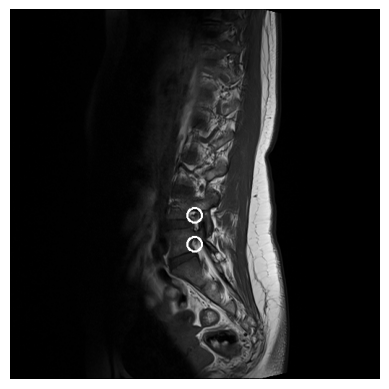

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=6 | img.dicom.PixelSpacing=[0.68359375, 0.68359375] | img.dicom.ImagePositionPatient=[-5.6987657975793, -121.75701123826, -329.34008963465]
(x=287.9524725574838,y=159.69535920637833), right_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=277.27838242659544,y=200.16793087747536), right_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=266.15954341287187,y=242.864272690174), right_neural_foraminal_narrowing_l3_l4, Normal/Mild


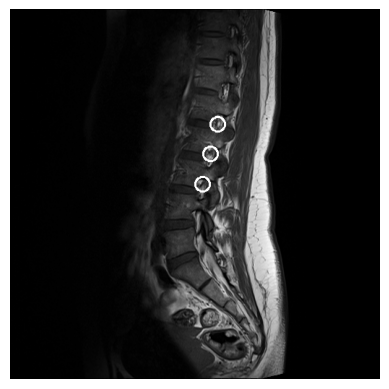

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=11 | img.dicom.PixelSpacing=[0.68359375, 0.68359375] | img.dicom.ImagePositionPatient=[16.681899981534, -120.84291059129, -329.51398451685]
(x=259.219512195122,y=330.1922525107604), left_neural_foraminal_narrowing_l4_l5, Normal/Mild
(x=270.2381635581062,y=372.0631276901004), left_neural_foraminal_narrowing_l5_s1, Normal/Mild


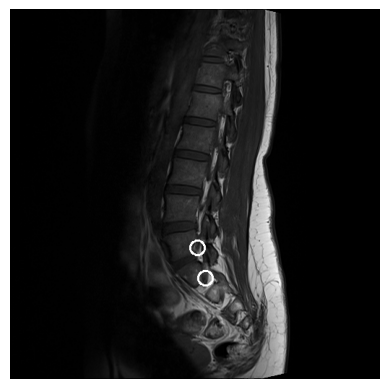

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=12 | img.dicom.PixelSpacing=[0.68359375, 0.68359375] | img.dicom.ImagePositionPatient=[21.158033328092, -120.66009122484, -329.54876349925]
(x=284.9296987087518,y=202.37589670014347), left_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=271.7073170731707,y=250.12338593974172), left_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=261.4232424677188,y=291.9942611190818), left_neural_foraminal_narrowing_l3_l4, Normal/Mild


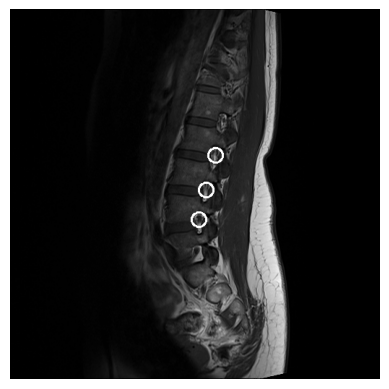

In [16]:
display_images(patient_info, Scan.SagittalT1)

2168 1084


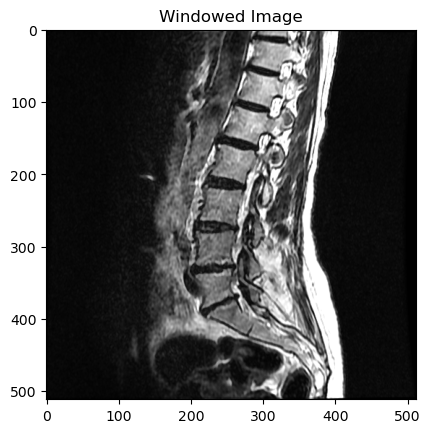

In [15]:



for img in patient_info.get_scans(Scan.SagittalT2_STIR):


    if img.SOPInstanceUID in [6]:
        print(img.dicom.WindowWidth, img.dicom.WindowCenter)
        windowed_image = apply_window(img.dicom.pixel_array, 150, 1400)

        
        windowed_image = cv2.normalize(windowed_image, None, alpha=0, beta=255, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_8U)
        for label in img.labels:
            
            c = (int(label.x), int(label.y))
            windowed_image = cv2.circle(windowed_image.copy(), c, 10, (255,0,0), 2)
    
        
        plt.imshow(windowed_image, cmap=plt.cm.gray)
        plt.title('Windowed Image')
        plt.show()

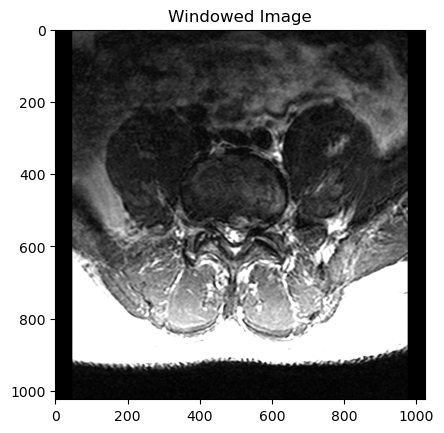

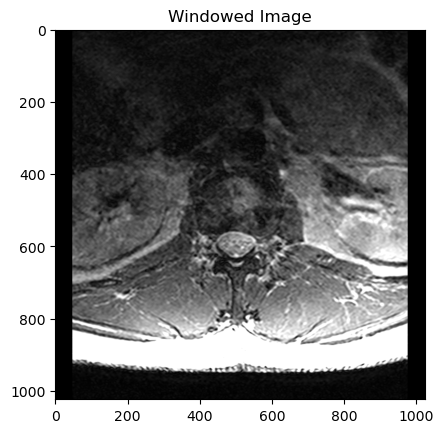

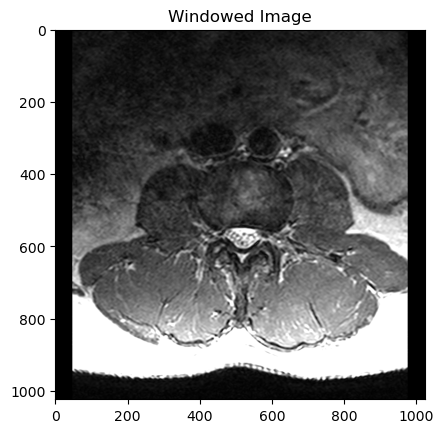

In [58]:



for img in [patient_info.get_scans(Scan.AxialT2)[6], patient_info.get_scans(Scan.AxialT2)[27], patient_info.get_scans(Scan.AxialT2)[16]]:
    # img.dicom.WindowWidth = 400
    # img.dicom.WindowCenter = 100
    windowed_image = apply_window(img.dicom.pixel_array, 100, 400)
    plt.imshow(windowed_image, cmap=plt.cm.gray)
    plt.title('Windowed Image')
    plt.show()

# display_images(patient_info, Scan.AxialT2)

In [20]:
num_axial_scans = []
for patient_id in tqdm(patient_ids):
    patient_info = PatientInfo.from_df(patient_id, train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")
    num_axial_scans.append(len(patient_info.get_scans(Scan.AxialT2)))

100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1975/1975 [01:54<00:00, 17.28it/s]


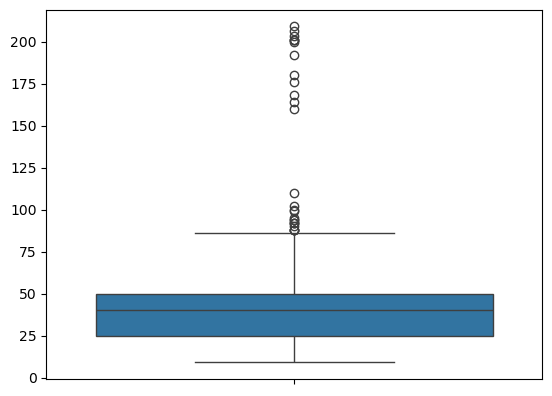

In [21]:
sns.boxplot(num_axial_scans)
plt.show()

In [22]:
np.mean(num_axial_scans),  np.std(num_axial_scans), np.max(num_axial_scans), np.min(num_axial_scans)

(40.49569620253165, 20.56318097612999, 209, 9)

In [18]:

global_diff_locs = []


for patient_id in tqdm(patient_ids):
    patient_info = PatientInfo.from_df(patient_id, train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")

    img_locs = sorted([img.dicom.ImagePositionPatient[-2] for img in patient_info.get_scans(Scan.AxialT2)])

    diff_locs = [abs(i - j) for i,j in zip(img_locs,img_locs[1:]) ]

    global_diff_locs.append(np.mean(diff_locs))

    
    
        

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1975/1975 [01:50<00:00, 17.82it/s]


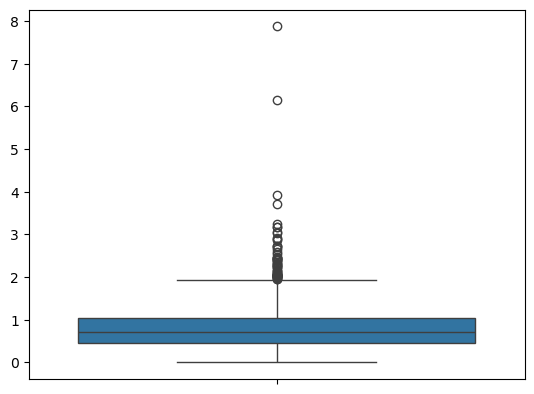

In [21]:

sns.boxplot(global_diff_locs)
plt.show()

In [22]:

np.mean(global_diff_locs),  np.std(global_diff_locs), np.max(global_diff_locs), np.min(global_diff_locs)

(0.7967068780347774, 0.5544542999955234, 7.872595833333333, 0.0)

In [27]:
N_CLASSES = 2
HIDDEN_DIM = 768
MODEL_NAME = "tf_efficientnet_b5.ns_jft_in1k"
DEVICE = "cuda:0"

In [30]:

model = DetectionModel(MODEL_NAME, n_classes=N_CLASSES, coord_dim=2, hidden_dim=HIDDEN_DIM).to(DEVICE)

model.load_state_dict(torch.load("../models/axial_t2/best_loc_model_fold-0.pt"))
# ds = SubarticularSteneosisDataLoader(train_df["study_id"], transformations=[])

Unexpected keys (bn2.bias, bn2.num_batches_tracked, bn2.running_mean, bn2.running_var, bn2.weight, classifier.bias, classifier.weight, conv_head.weight) found while loading pretrained weights. This may be expected if model is being adapted.


<All keys matched successfully>

In [89]:
plt.style.use('ggplot')


p_id: 3421594215, num imgs: 64


/home/paradox/.local/lib/python3.12/site-packages/mpld3/mplexporter/exporter.py:84: UserWarning: Blended transforms not yet supported. Zoom behavior may not work as expected.
  warnings.warn("Blended transforms not yet supported. "


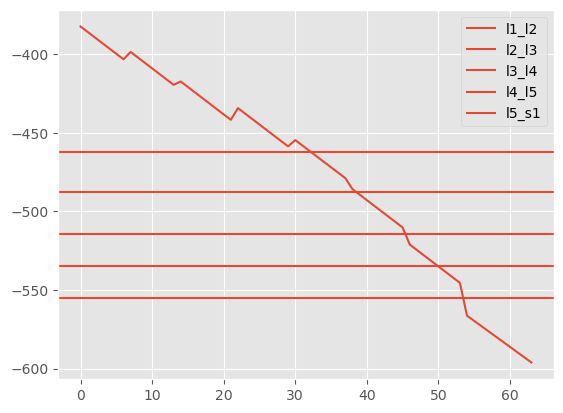

In [109]:
p_id = random.choice(train_df["study_id"])
patient_info = PatientInfo.from_df(p_id, train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")
imgs = patient_info.get_scans(Scan.AxialT2)
print(f"p_id: {p_id}, num imgs: {len(imgs)}")

# tuple of 5
disc_locs = [-1 for _ in range(5)]

ax = plt.subplot(111)

for scan in Scan.all_scans():
    for img in patient_info.get_scans(scan):
        for label in img.labels:
            if label.location.condition == Condition.SCS:
                disc_locs[label.location.disc_level.to_int()] = float(img.dicom.ImagePositionPatient[-1]) - label.y * img.dicom.PixelSpacing[0]


for idx, loc in enumerate(disc_locs):
    ax.axhline(y=loc, linestyle='-', xmin=0, xmax=len(imgs), label=DiscLevel.from_int(idx))
    ax.legend()
    
ax.plot([*range(len(imgs))], [img.dicom.ImagePositionPatient[-1] for img in imgs])
# plt.scatter([*range(1,6)], disc_locs)


In [110]:
# [float(img.dicom.ImagePositionPatient[-1]) for img in imgs]

In [15]:

disc_dists = {i: [] for i in range(4) }


for patient_id in tqdm(patient_ids):

    disc_locs = [0,0,0,0,0]
    
    patient_info = PatientInfo.from_df(patient_id, train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")
    
    for scan in Scan.all_scans():
        for img in patient_info.get_scans(scan):
            for label in img.labels:
                if label.location.condition == Condition.SCS:
                    disc_locs[label.location.disc_level.to_int()] = float(img.dicom.ImagePositionPatient[-1]) - label.y * img.dicom.PixelSpacing[0]


    for idx, (loc1, loc2) in enumerate(zip(disc_locs, disc_locs[1:])):
        disc_dists[idx].append(abs(loc1 - loc2))

    

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1975/1975 [01:55<00:00, 17.03it/s]


In [17]:
m,s = [], []
for k, dists in disc_dists.items():
    print(f"{k=},{np.mean(dists)=},{np.std(dists)}")
    m.append(np.mean(dists))
    s.append(np.std(dists))

print(f"global mean: {np.mean(m):.4f}, global std: {np.mean(s):.4f}")

k=0,np.mean(dists)=34.57820255549729,30.90829388835926
k=1,np.mean(dists)=32.728585534766005,16.023725694034425
k=2,np.mean(dists)=30.759669346568362,6.906320555573367
k=3,np.mean(dists)=25.630960840935256,9.833658739991257
global mean: 30.9244, global std: 15.9180


In [49]:

patient_info = PatientInfo.from_df(train_df["study_id"][3], train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")

for img in patient_info.get_scans(Scan.SagittalT2_STIR):
    print(img.dicom.ImagePositionPatient[2])




171.797
171.834
171.872
171.91
171.948
171.985
172.023
172.061
172.099
172.136
172.174
172.212
172.25
172.287
172.325


In [54]:
sagittal_z = []
diff_pixel_spacing = 0
for patient_id in tqdm(patient_ids):
    
    patient_z = []
    patient_info = PatientInfo.from_df(patient_id, train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")

    pixel_spacing = None
    added_counter = False

    for img in patient_info.get_scans(Scan.SagittalT2_STIR):
        
        patient_z.append(img.dicom.ImagePositionPatient[2])

        if pixel_spacing is None:
            pixel_spacing = img.dicom.PixelSpacing


        if pixel_spacing != img.dicom.PixelSpacing and not added_counter:
            added_counter = True
            diff_pixel_spacing += 1
            

    if len(patient_z) != 0:
        sagittal_z.append(np.std(patient_z))
    
    

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1975/1975 [00:59<00:00, 33.17it/s]


In [52]:
np.mean(sagittal_z),  np.std(sagittal_z), diff_pixel_spacing

(0.6434266117911002, 0.673741843519089, 0)

<Axes: >

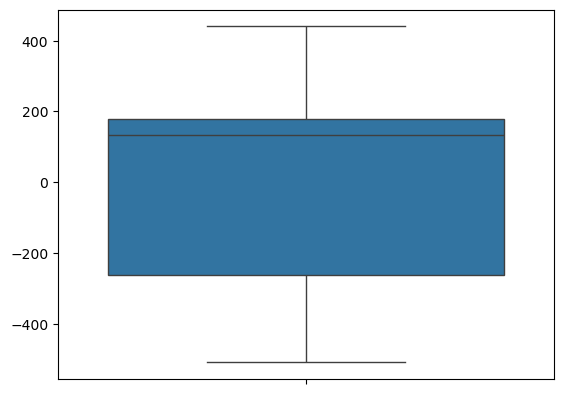

In [37]:
sns.boxplot(sagittal_z)

In [35]:
patient_info = PatientInfo.from_df(train_df["study_id"][2], train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=4 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-13.831, -131.076, 165.493]
(x=198.2657004830918,y=268.9855072463768), right_neural_foraminal_narrowing_l5_s1, Normal/Mild


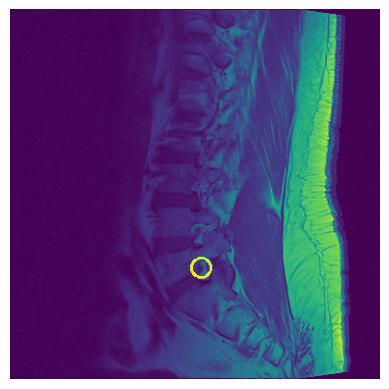

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=5 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-9.23202, -131.078, 165.397]
(x=214.3429951690821,y=105.7391304347826), right_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=202.59420289855072,y=142.84057971014494), right_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=200.7391304347826,y=187.98067632850243), right_neural_foraminal_narrowing_l3_l4, Normal/Mild
(x=197.0289855072464,y=224.46376811594203), right_neural_foraminal_narrowing_l4_l5, Normal/Mild


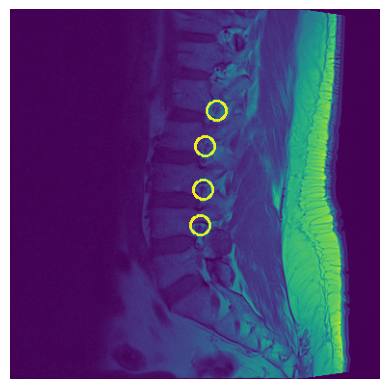

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=12 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[22.9609, -131.095, 164.722]
(x=210.3030511635561,y=104.76639613830116), left_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=205.97976233844665,y=147.42098804087345), left_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=193.91273442336103,y=233.74949644817505), left_neural_foraminal_narrowing_l4_l5, Normal/Mild
(x=199.49312761060668,y=272.4181214905936), left_neural_foraminal_narrowing_l5_s1, Normal/Mild


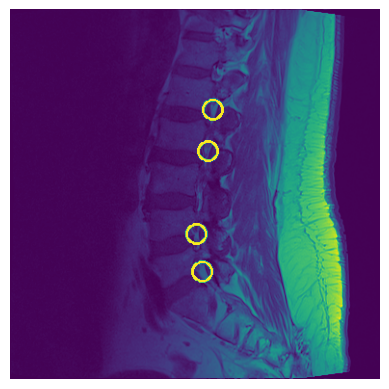

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=13 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[27.5599, -131.097, 164.626]
(x=197.023515622053,y=195.78472030939895), left_neural_foraminal_narrowing_l3_l4, Normal/Mild


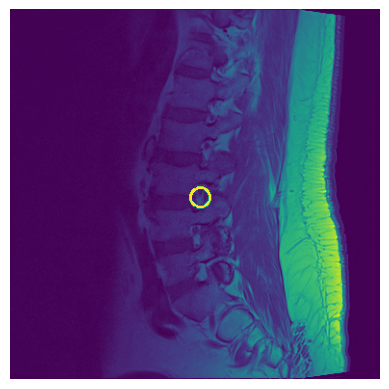

In [36]:
display_images(patient_info, Scan.SagittalT1, crop_image=False)

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=4 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-13.831, -131.076, 165.493]
(x=198.2657004830918,y=268.9855072463768), right_neural_foraminal_narrowing_l5_s1, Normal/Mild


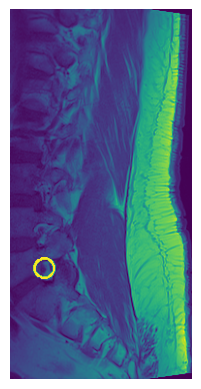

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=5 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-9.23202, -131.078, 165.397]
(x=214.3429951690821,y=105.7391304347826), right_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=202.59420289855072,y=142.84057971014494), right_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=200.7391304347826,y=187.98067632850243), right_neural_foraminal_narrowing_l3_l4, Normal/Mild
(x=197.0289855072464,y=224.46376811594203), right_neural_foraminal_narrowing_l4_l5, Normal/Mild


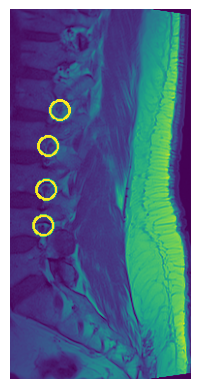

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=12 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[22.9609, -131.095, 164.722]
(x=210.3030511635561,y=104.76639613830116), left_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=205.97976233844665,y=147.42098804087345), left_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=193.91273442336103,y=233.74949644817505), left_neural_foraminal_narrowing_l4_l5, Normal/Mild
(x=199.49312761060668,y=272.4181214905936), left_neural_foraminal_narrowing_l5_s1, Normal/Mild


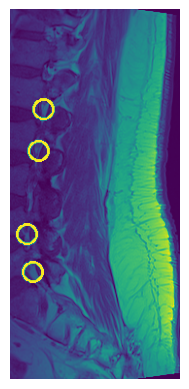

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=13 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[27.5599, -131.097, 164.626]
(x=197.023515622053,y=195.78472030939895), left_neural_foraminal_narrowing_l3_l4, Normal/Mild


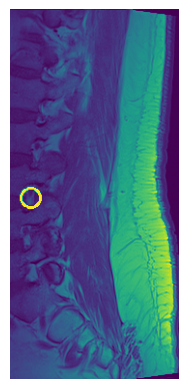

In [37]:

display_images(patient_info, Scan.SagittalT1, crop_image=True)

In [15]:
img = patient_info.get_scans(Scan.SagittalT2_STIR)[7]

In [19]:
img.dicom.pixel_array.shape,  img.dicom.PixelSpacing

((320, 320), [0.9375, 0.9375])

In [21]:

pixel_spacing = img.dicom.PixelSpacing[0]
start = img.dicom.ImagePositionPatient[2]

for i in range(5):
    
    level = DiscLevel.from_int(i)

    for label in img.labels:
        if label.location.disc_level == level:
            print(f"{level=}, loc: {start - pixel_spacing * label.y}")

level=<DiscLevel.l1_l2: 'l1_l2'>, loc: 81.60401075268818
level=<DiscLevel.l2_l3: 'l2_l3'>, loc: 51.49648387096775
level=<DiscLevel.l3_l4: 'l3_l4'>, loc: 23.001860215053767
level=<DiscLevel.l4_l5: 'l4_l5'>, loc: -7.10566666666665
level=<DiscLevel.l5_s1: 'l5_s1'>, loc: -29.686311827957013


In [24]:
r_img, labels = img.resize(512,512)

In [27]:

pixel_spacing = (img.dicom.PixelSpacing[0] * img.dicom.pixel_array.shape[0]) / 512
start = img.dicom.ImagePositionPatient[2]

for i in range(5):
    
    level = DiscLevel.from_int(i)

    for label in labels:
        if label.location.disc_level == level:
            print(f"{level=}, loc: {start - pixel_spacing * label.y}")

level=<DiscLevel.l1_l2: 'l1_l2'>, loc: 81.60401075268817
level=<DiscLevel.l2_l3: 'l2_l3'>, loc: 51.49648387096775
level=<DiscLevel.l3_l4: 'l3_l4'>, loc: 23.001860215053767
level=<DiscLevel.l4_l5: 'l4_l5'>, loc: -7.10566666666665
level=<DiscLevel.l5_s1: 'l5_s1'>, loc: -29.686311827957013


In [26]:

left_right_dist = []
right_canal_dist = []

for patient_id in tqdm(patient_ids):
    
    patient_info = PatientInfo.from_df(patient_id, train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")

    left_neural_foraminal_narrowing  = [0 for _ in range(5)]
    right_neural_foraminal_narrowing = [0 for _ in range(5)]

    for img in patient_info.get_scans(Scan.SagittalT1):
        
        for label in img.labels:
            z_loc = img.dicom.ImagePositionPatient[2] - img.dicom.PixelSpacing[0] * label.y
            if label.location.condition == Condition.LNFN:
                left_neural_foraminal_narrowing[label.location.disc_level.to_int()] = z_loc
            if label.location.condition == Condition.RNFN:
                right_neural_foraminal_narrowing[label.location.disc_level.to_int()] = z_loc

    canal_steneosis_levels = [0 for _ in range(5)]
    for img in patient_info.get_scans(Scan.SagittalT2_STIR):
        
        for label in img.labels:
            if label.location.condition == Condition.SCS:
                z_loc = img.dicom.ImagePositionPatient[2] - img.dicom.PixelSpacing[0] * label.y
                canal_steneosis_levels[label.location.disc_level.to_int()] = z_loc

    if 0 not in left_neural_foraminal_narrowing and 0 not in right_neural_foraminal_narrowing:
        right_neural_foraminal_narrowing = np.array(right_neural_foraminal_narrowing)
        left_neural_foraminal_narrowing = np.array(left_neural_foraminal_narrowing)
        left_right_dist.append(np.mean(np.abs(right_neural_foraminal_narrowing - left_neural_foraminal_narrowing)))
        
    if 0 not in right_neural_foraminal_narrowing and 0 not in canal_steneosis_levels:
        right_neural_foraminal_narrowing = np.array(right_neural_foraminal_narrowing)
        canal_steneosis_levels = np.array(canal_steneosis_levels)
        right_canal_dist.append(np.mean(np.abs(right_neural_foraminal_narrowing - canal_steneosis_levels)))

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████| 1975/1975 [01:00<00:00, 32.74it/s]


In [29]:
np.mean(right_canal_dist),  np.std(right_canal_dist)

(6.953802180081909, 4.4710894337684675)

In [30]:
np.mean(left_right_dist),  np.std(left_right_dist)

(3.375288295681762, 4.562356988177302)

In [14]:

patient_info = PatientInfo.from_df(train_df["study_id"][0], train_df, train_series_descriptions_df, train_label_coordinates_df, "../data/train_images")


scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=4 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-17.481644, -76.66989, -282.95724]
(x=187.96175908221795,y=251.83938814531547), right_neural_foraminal_narrowing_l4_l5, Moderate
(x=198.2409177820268,y=285.6137667304015), right_neural_foraminal_narrowing_l5_s1, Normal/Mild


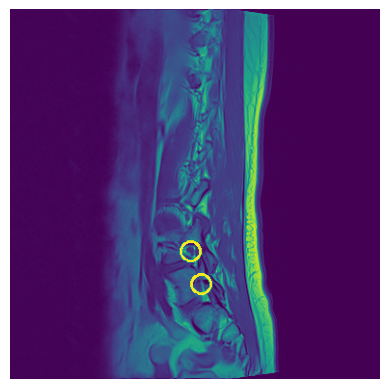

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=5 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-12.681765, -76.66419, -282.92386]
(x=187.22753346080304,y=210.72275334608028), right_neural_foraminal_narrowing_l3_l4, Moderate


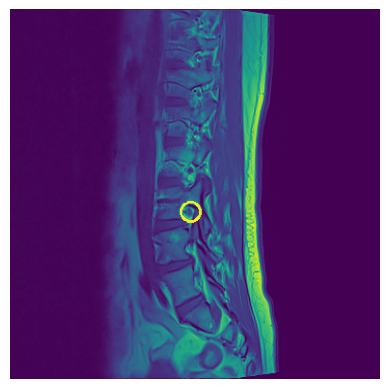

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=6 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[-7.8818836, -76.6585, -282.8905]
(x=194.56978967495215,y=127.75525812619502), right_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=191.63288718929252,y=165.93499043977056), right_neural_foraminal_narrowing_l2_l3, Normal/Mild


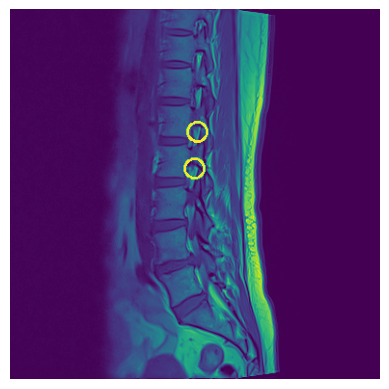

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=11 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[16.11752, -76.630035, -282.7236]
(x=196.07067137809187,y=126.02120141342756), left_neural_foraminal_narrowing_l1_l2, Normal/Mild
(x=186.50447227191407,y=251.5921288014311), left_neural_foraminal_narrowing_l4_l5, Moderate
(x=197.10056925996207,y=289.45730550284634), left_neural_foraminal_narrowing_l5_s1, Normal/Mild


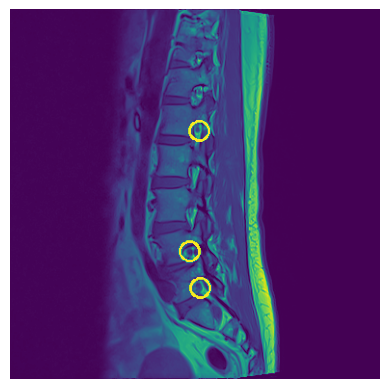

scan=<Scan.SagittalT1: 'Sagittal T1'> | img.SOPInstanceUID=12 | img.dicom.PixelSpacing=[0.78125, 0.78125] | img.dicom.ImagePositionPatient=[20.9174, -76.62434, -282.69022]
(x=191.32155477031804,y=170.1201413427562), left_neural_foraminal_narrowing_l2_l3, Normal/Mild
(x=187.8783542039356,y=217.24508050089443), left_neural_foraminal_narrowing_l3_l4, Normal/Mild


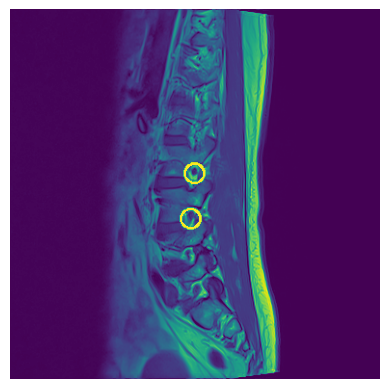

In [18]:
display_images(patient_info, Scan.SagittalT1)

In [22]:
-282.8905 - 0.78125 * 127

-382.10925